In [3]:
from scipy import stats
import pandas as pd 
import math
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib import rcParams
import numpy as np
import folium
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
import ipywidgets as widgets
from IPython.display import display, HTML
from scipy import stats


In [2]:
javascript_functions = {False: "hide()", True: "show()"}
button_descriptions  = {False: "Show code", True: "Hide code"}


def toggle_code(state):

    """
    Toggles the JavaScript show()/hide() function on the div.input element.
    """

    output_string = "<script>$(\"div.input\").{}</script>"
    output_args   = (javascript_functions[state],)
    output        = output_string.format(*output_args)

    display(HTML(output))


def button_action(value):

    """
    Calls the toggle_code function and updates the button description.
    """

    state = value.new

    toggle_code(state)

    value.owner.description = button_descriptions[state]


state = False
toggle_code(state)

button = widgets.ToggleButton(state, description = button_descriptions[state])
button.observe(button_action, "value")

display(button)

ToggleButton(value=False, description='Show code')

#  A prosperous but noisy city: Noise analysis in New York

# Introduction

The "City That Never Sleeps"—New York is a city of superlatives: America's biggest; the most exciting; the business and cultural capitals; the nation's trendsetter. The city seems to pull in the best and the brightest from every corner of the country. The city aroused our great interest.<br>

In [3]:

html1 = '<img src="New york map.png" width="600" height="300" align="center"/>'
HTML(html1)


Fig 1.The map of New York city and 5 boroughs

[311 hotline](https://www.govtech.com/dc/articles/What-is-311.html) is a non-emergency phone number that people can call in many cities to find information about services, make complaints, or report problems like graffiti or road damage. Even in cities where a different phone number is used, 311 is the generally recognized moniker for non-emergency phone systems.

Since its inception, 311 has evolved with technological advances into a multi-channel service that connects citizen with government, while also providing a wealth of data that improves how cities are run. 

We found a dataset about the records of 311 Service Requests from 2010-2020. It can be a good material if we want to discover New yorkers' life and present a panorama to you！<br>

The first inspiration is about what New Yorkers complain most in their daily life.<br>

In [4]:
# import matplotlib.pyplot as plt
# import matplotlib.image as mpimg
# from matplotlib import rcParams

# %matplotlib inline

# # figure size in inches optional
# rcParams['figure.figsize'] = 20,10

# # read images
# img_0 = mpimg.imread('The complaint type statistics.png')


# # display images
# fig, ax = plt.subplots(1,1)
# ax.set_axis_off()
# ax.imshow(img_0)
html1 = '<img src="The complaint type statistics.png" width="500" height="200" align="center"/>'
HTML(html1)


Fig.2 The 15 most frequent complaint type in New York fro 2010 to 2020.

It is easy to see that 'Noise-Residential' was most frequently complained about. Furthermore, we found that the noise cases have been sorted into 5 main clases：

  * Residential
  * Street/Sidewalk
  * Commercial
  * Vehicle
  * Noise (means others)

and then 36 subclasses (e.g. Barking dog or construction equipment). It indicates that the data has been well organized to cover a great number types of noise. Therefore, we believe noise can be the best representation of some aspects of New Yorkers' life.

We would like to present some interesting insights about what the real situation is and how it has changed in New York, by exploring the story through temporal and spatial distribution and variation from different types of noise.

# Choropleth map for distribution of noise cases acrss different blocks for 2019.

In the first place, we want to present the recent situation. 2019 is chosen as the time range because it is not affected by the outbreak of New York. As [New York Open Data](https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9) describes, 311 is receiving the unprecedented volume during the Covid-19 crisis and the data may not present a full picture.

We considered to sum up all the noise cases. It is of great interst to see how the reported noise cases are distributed among blocks of different zipcodes by choropleth map. It is an interactive map which shows not only overall distribution of the reported cases but also detailed information of each block. When you put your mouse on a maker and click it, you will get the zip number, block name and the density of noise (Evaluated by cases per hectare). Please try it out. <br>


In [5]:
# Input the data

zip_count=pd.read_csv('zip_count.csv')
blockname=pd.read_csv('blockname.csv')
blockname=blockname['0']
ziparea=pd.read_csv('ziparea.csv')
ziparea=ziparea['area']
coordinates=pd.read_csv('coordinates.csv')
zip_count=zip_count.loc[:,['zip','number']]

In [6]:
# Plot the choropleth map
# To create the choropleth
 
zip_count['zip']=zip_count['zip'].astype('str')
zip_count.loc[82,'zip']='00083'#the zip code should be specificially treated.

# Create a folium map at New York.
map1 = folium.Map(location=[40.693943, -73.985880], default_zoom_start=12)
# Putting the data into to create a choropleth map.
choropleth = folium.Choropleth(geo_data='nyc-zip-code-tabulation-areas-polygons.geojson',
                               data=zip_count, columns=['zip', 'number'], 
                               key_on='feature.properties.postalCode', fill_color='PuRd', 
                               fill_opacity=0.7,line_opacity=0.2, legend_name='Distribution of noise cases in 2019',
                               highlight=True,smooth_factor=0).add_to(map1)


# Create marker to help readers to get detailed information.
marker_cluster = MarkerCluster().add_to(map1) # create marker clusters
for i in range(zip_count.shape[0]):
    location = [coordinates.loc[i,'lat'],coordinates.loc[i,'lon']]
    tooltip = "Zipcode:{}. <br> Click for more".format(zip_count['zip'][i])
    #tooltip = "Zipcode:{}<br> Borough: {}<br> Click for more".format(zip_count['zip'][i], belongedborough[i])
    folium.Marker(location, 
                  popup="""<i>Zipcode: </i> <br> <b>{}</b> <br>
                  <i>Block name: </i><b><br>{}</b><br>
                  <i>Cases per hectare: </i><b><br>{}</b><br>""".format(zip_count['zip'][i], blockname[i], zip_count['number'][i]), 
                  tooltip=tooltip).add_to(marker_cluster)
map1

# Take https://www.kaggle.com/saidakbarp/nyc-property-sales-eda-map-analysis/data for comparison

It illustrates that Manhattan is the most noisy borough as most of the blocks in Manhattan are in dark colors which means a higher density of reported cases. Brooklyn or The Bronx is deemed as the second and only with some blocks in dark. For the other two boroughs, the noise level is much smaller.
<br>

It may raise a speculation that Manhattan is the most crowded and Brooklyn/The Bronx ranks second because noise level is highlighly related to human acitivity. As [Wikipedia](https://en.wikipedia.org/wiki/Boroughs_of_New_York_City) illustrates, it is the case. Manhattan has the largest population density, 27,826 persons per km<sup>2</sup> while Brooklyn has the second largest, 14,649 persons per km<sup>2</sup>. The Bronx ranks third but it has 13,231 persons per km<sup>2</sup>, which is very close to Brooklyn. 


![example](https://github.com/lingwsh/SocialData/blob/master/Final%20Project/img/qz_img/population.png?raw=true) 

Fig.3 Basic stats of five borough's of New York, which is obtained from [Wikipedia](https://en.wikipedia.org/wiki/Boroughs_of_New_York_City) 

The map may also raise a question that no blocks which has a noise density of more than 22 cases per hectare are shown in the map when you have a overview of the New York city. Please do not be confused and zoom in Manhattan, you will find some small blocks with rather high noise density. For example, we have a detected the block which has around 25.6 cases per hectare in 2019. After investigation of the area, we found that the block is acctually a skyscapper with flagship shops of fashion brands on its ground floor. Besides, It needs to be mentionted that Manhattan is the borough where most of the high level blocks are located.

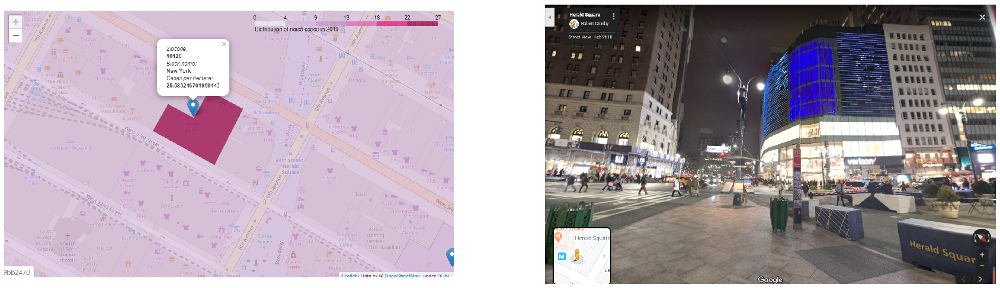

In [7]:


# figure size in inches optional
rcParams['figure.figsize'] = 30 ,15

# read images
img_A = mpimg.imread('zipcode 10120.PNG')
img_B = mpimg.imread('Herald Square.PNG')

# display images
fig, ax = plt.subplots(1,2)
ax[0].set_axis_off()
ax[1].set_axis_off()
ax[0].imshow(img_A);
ax[1].imshow(img_B);

Fig.4 The investigation by Google Map of one of the loudest blocks shown in the map. The left shows the location, name and density of cases of the block. The right shows the practical situation of its enviroment. The block is loacated on the right side of H&M, which is a skyscapper named Kratter Building.

We believe the above map can provide the information for people who pay much attention to noise when they are considering the location of the accomodation. So we would like to make a comparison between distribution of the average property price and the one of the reported noise cases. The analysis of property price is done by [Saidakbarp](https://www.kaggle.com/saidakbarp/nyc-property-sales-eda-map-analysis/data#Map-analysis) <br>

From the comparison, We found that Manhattan is the most expensive and loudest place to live. Central part of Brooklyn also has pricier accomodation and loud enviroment. It is believed that high noise level indicates convinience for recreataion and transportation which leads to high property price. Furthermore, high property price does not sufficiently indicate high noise level, which can be confirmed by some areas on the Staten Island. It is also a common for some places with luxurious mansions in peaceful environment and a few super rich living in.

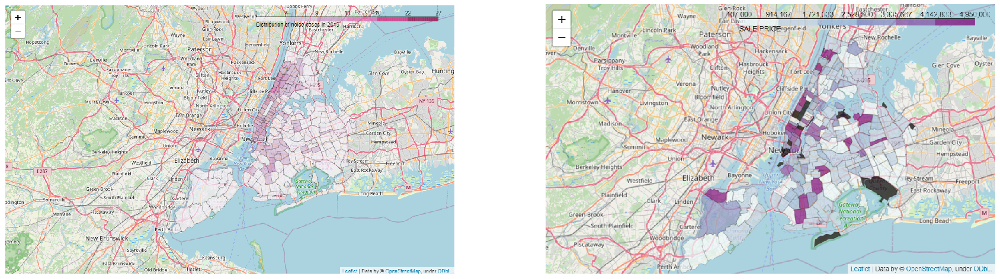

In [8]:

%matplotlib inline
%matplotlib inline

# figure size in inches optional
rcParams['figure.figsize'] = 30,15

# read images
img_1 = mpimg.imread('distribution of noise.PNG')
img_2 = mpimg.imread('distribution of property price.PNG')

# display images
fig, ax = plt.subplots(1,2)
ax[0].set_axis_off()
ax[1].set_axis_off()
ax[0].imshow(img_1);
ax[1].imshow(img_2);

Fig 6. The comparison of the noise level (left) and property price for each block. They have a similar distribution generally. However, it needs to be mentioned that the [Saidakbarp](https://www.kaggle.com/saidakbarp/nyc-property-sales-eda-map-analysis/data#Map-analysis) may have had some zipcodes invalid as the color of black means a default value. <br>

# Distributions of various noise subtypes in different boroughs

Noise is divided into about five categories in 311 dataset, namely 'Noise-residential','Noise-Vehicle',
'Noise-Street','Noise-Commercial','Noise(others)'. However,36 subsets are found under these 5 categories.These arouse our great interest.Thus,we made an interactive bar that shows the distribution of top ten noise subcategories in the five boroughs of New York in 2019. 

In [71]:
top_descriptor = ['Loud Music/Party','Banging/Pounding','Loud Talking',
                      'Noise: Construction Before/After Hours (NM1)','Car/Truck Music','Car/Truck Horn',
                     'Engine Idling','Noise, Barking Dog (NR5)','Noise: Construction Equipment (NC1)',
                     'Noise: air condition/ventilation equipment (NV1)']
borough=['BROOKLYN', 'MANHATTAN', 'BRONX', 'STATEN ISLAND', 'QUEENS']

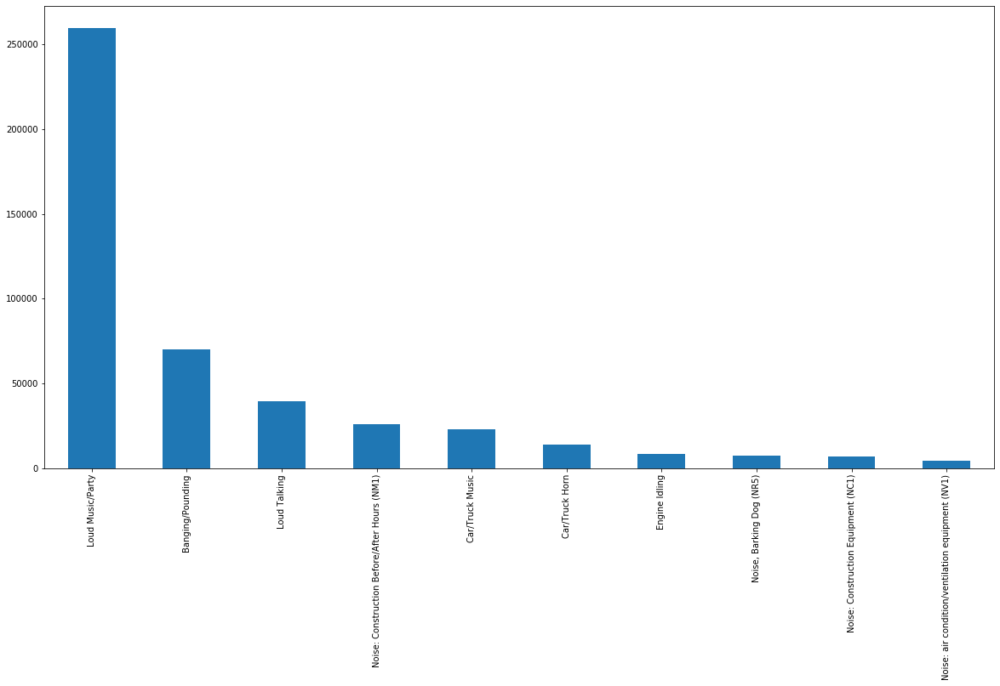

In [72]:
# load the csv file into a pandas dataframe
data=pd.read_csv('bar.csv')
a = data['Descriptor'].value_counts()
a.plot(kind='bar',figsize=(20,10))

In [73]:
norm_top_descriptor=pd.DataFrame()

for i in top_descriptor:
    one_top_descriptor=data[data['Descriptor']==i]
    one_top_descriptor=one_top_descriptor.groupby('Borough').count()['year']
    total=one_top_descriptor.sum()
    a=one_top_descriptor/total
    
    norm_top_descriptor[i]=a
norm_top_descriptor=norm_top_descriptor.fillna(0)


In [74]:
norm_top_descriptor

,Loud Music/Party,Banging/Pounding,Loud Talking,Noise: Construction Before/After Hours (NM1),Car/Truck Music,Car/Truck Horn,Engine Idling,"Noise, Barking Dog (NR5)",Noise: Construction Equipment (NC1),Noise: air condition/ventilation equipment (NV1)
Borough,,,,,,,,,,
BRONX,0.233681,0.255675,0.174139,0.037763,0.322236,0.033804,0.067819,0.100125,0.057818,0.044988
BROOKLYN,0.295598,0.270083,0.301928,0.267651,0.287096,0.145566,0.300895,0.228085,0.309810,0.229526
MANHATTAN,0.263311,0.267423,0.309644,0.538879,0.234937,0.185668,0.333777,0.195125,0.448341,0.549247
QUEENS,0.183684,0.181416,0.178819,0.136517,0.140030,0.626927,0.270914,0.201219,0.159687,0.164883
STATEN ISLAND,0.023726,0.025403,0.035470,0.019189,0.015701,0.008035,0.026596,0.275447,0.024344,0.011356


In [75]:
n = {}
n['descriptors']=list(norm_top_descriptor.columns)
for i in range(0,len(list(norm_top_descriptor.index))):
     n[norm_top_descriptor.index[i]]= list(norm_top_descriptor.iloc[i,:])

In [82]:
from bokeh.models import ColumnDataSource,Legend,HoverTool
from bokeh.models.ranges import FactorRange
from bokeh.palettes import viridis
from bokeh.transform import dodge
from bokeh.plotting import figure,show
from bokeh.core.properties import value
from bokeh.io import output_notebook
from bokeh.models import ColumnDataSource, DataRange1d, Plot, LinearAxis, Grid, Legend, LegendItem
output_notebook()


Loading BokehJS ...

In [86]:
## convert df to bokeh
source = n
colors = ["#c9d9d3", "#718dbf", "#e84d60","#d9c9cf","#d29cab"]


descriptors=[str(i) for i in norm_top_descriptor]

p = figure(x_range=descriptors, plot_height=700, title="Top10 Noise subset distribution",
           toolbar_location=None, tools="hover", tooltips="$name @descriptors: @$name")

boroughs = [str(i) for i in norm_top_descriptor.index]

p.vbar_stack(boroughs, x='descriptors', width=0.9, color=colors, source=n,
             legend_label=boroughs)
# p.legend.location = "top_left"
# p.legend.orientation = "horizontal"
p.legend.label_text_font_size = '5pt'
p.xaxis.major_label_orientation = math.pi/2




show(p)

<font color='red'> 2.legend需要调整到右侧</font> 

The x-axis of the interactive bar above is sorted by the total volume of top 10 noise descriptors.
Let's start with the subcategory that has the most complaints:Loud music/party.Brooklyn has the largest percentage, nearly 30%, the proportions of the other three boroughs also varied little, while staten island accounts for just 2%.
We believe that, first of all, the number of people in each borough and the average population per square meter is one of the main factors affecting the volume of noise complaints, so we wonder if <b>the population density of Staten island is less than that of the other four boroughs.

We gathered information about the population in the five boroughs of New York,as it cound be seen from Figure 3 and the results were exactly what we expected.
The census is not conducted every year in the United States, thus, estimate population are used in years when there is no census. In terms of population density, Manhattan has the highest population density, followed by Brooklyn, The Bronx, Queens and Staten Island.
$$𝑀𝑎𝑛ℎ𝑎𝑡𝑡𝑎𝑛(42\%)>𝐵𝑟𝑜𝑜𝑘𝑙𝑦𝑛(21\%)>𝑇ℎ𝑒𝐵𝑟𝑜𝑛𝑥(20\%)>𝑄𝑢𝑒𝑒𝑛𝑠(12\%)>𝑆𝑡𝑎𝑡𝑒𝑛𝐼𝑠𝑙𝑎𝑛𝑑(4\%)$$

While the percentage of noise complaints about almost all types of noise in borough Staten Island was extremely small,however,One of the interesting things we found here is that the percentage of noise complaints about 'Dog Barking' was the largest among the five boroughs.


# Analysis of noise distribution characteristics in each borough


## Staten island


Based on our research, we found that Staten island is one of the most suburban areas in the boroughs, with 2,500 acres of forest in the middle of staten island, including nearly 28 miles of trails and the last remaining intact forest in New York City.
Compared with places like Manhattan and brooklyn, staten island is not as busy. The place is large and the environment is more natural,also, the average population is small. The older generation of white americans like to live in this borough.
In our opinion, the reason why the noise complaint rate of ‘dog barking’ on Staten island is high can be explainedas follows. First of all, the natural environment is the best here among five boroughs and there are many open spaces, which are suitable for keeping dogs. From the age characteristics of the main living population, the retired elderly also have more time to keep dogs.

<br>At this point, is the picture of Staten island already in your mind?

<br>Next, we want to take a closer look at Noise:Dog barking in Staten Island.
The bar chart of the changes over the decade is shown as follows.

In [15]:
monthList = pd.read_csv ('311-ac-Descriptor_Borough_monthGroupList.csv')

justMonthList = pd.read_csv ('311-ac-Descriptor_Borough_justMonth_GroupList.csv')

justDayList = pd.read_csv ('311-ac-Descriptor_Borough_justDay_GroupList.csv')

justHourList = pd.read_csv ('311-ac-Descriptor_Borough_justHour_GroupList.csv')

In [16]:
stList = monthList[(monthList['Borough'] == 'STATEN ISLAND') & (monthList['Descriptor'] == 'Noise, Barking Dog (NR5)')]

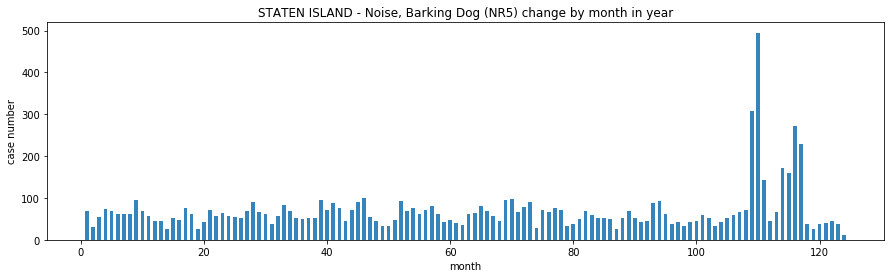

In [17]:
tempc = monthList[(monthList['Borough'] == 'STATEN ISLAND') & (monthList['Descriptor'] == 'Noise, Barking Dog (NR5)')]
cwh = [i for i in range(1,len(tempc)+1)]
tempc = tempc.sort_values(by=['year','month'])
plt.figure(figsize=(15,4))
plt.bar(cwh,height=tempc['monthSize'],width = 0.6,alpha=0.9)
plt.xlabel('month')
plt.ylabel('case number')
plt.title('STATEN ISLAND - Noise, Barking Dog (NR5) change by month in year')

plt.show()

As it can be seen from the figure, complaints about barking dogs on Staten island soared in early 2019, but fell sharply by the end of the year.To distinuish whether this change is unique to one borough or the entire city of New York, let's also take a look at bar plot in the other four boroughs.

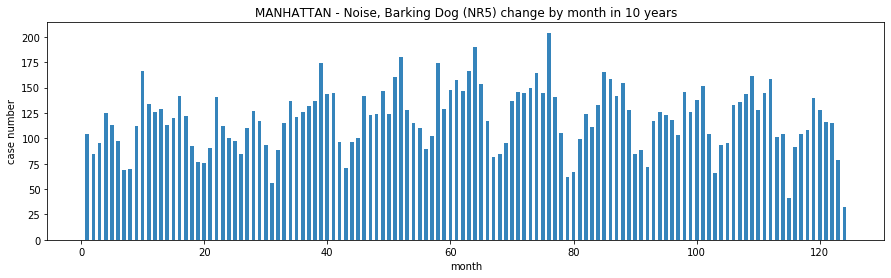

In [18]:
tempc = monthList[(monthList['Borough'] == 'MANHATTAN') & (monthList['Descriptor'] == 'Noise, Barking Dog (NR5)')]
cwh = [i for i in range(1,len(tempc)+1)]
tempc = tempc.sort_values(by=['year','month'])
plt.figure(figsize=(15,4))
plt.bar(cwh,height=tempc['monthSize'],width = 0.6,alpha=0.9)
plt.xlabel('month')
plt.ylabel('case number')
plt.title('MANHATTAN - Noise, Barking Dog (NR5) change by month in 10 years')

plt.show()

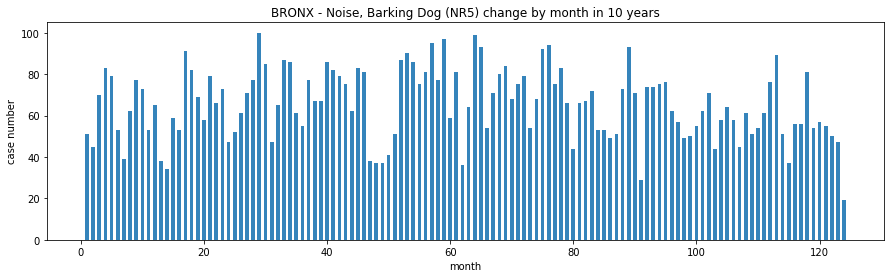

In [19]:
tempc = monthList[(monthList['Borough'] == 'BRONX') & (monthList['Descriptor'] == 'Noise, Barking Dog (NR5)')]
cwh = [i for i in range(1,len(tempc)+1)]
tempc = tempc.sort_values(by=['year','month'])
plt.figure(figsize=(15,4))
plt.bar(cwh,height=tempc['monthSize'],width = 0.6,alpha=0.9)
plt.xlabel('month')
plt.ylabel('case number')
plt.title('BRONX - Noise, Barking Dog (NR5) change by month in 10 years')

plt.show()

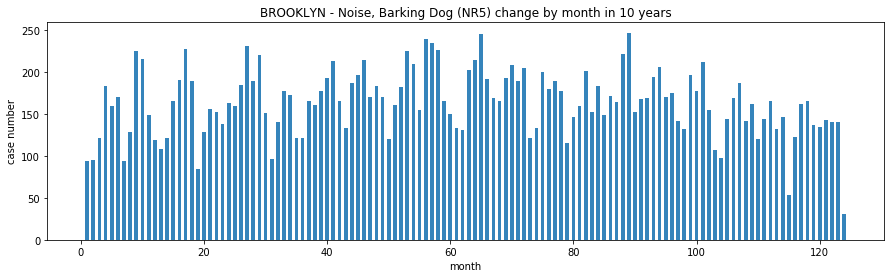

In [20]:
tempc = monthList[(monthList['Borough'] == 'BROOKLYN') & (monthList['Descriptor'] == 'Noise, Barking Dog (NR5)')]
cwh = [i for i in range(1,len(tempc)+1)]
tempc = tempc.sort_values(by=['year','month'])
plt.figure(figsize=(15,4))
plt.bar(cwh,height=tempc['monthSize'],width = 0.6,alpha=0.9)
plt.xlabel('month')
plt.ylabel('case number')
plt.title('BROOKLYN - Noise, Barking Dog (NR5) change by month in 10 years')

plt.show()

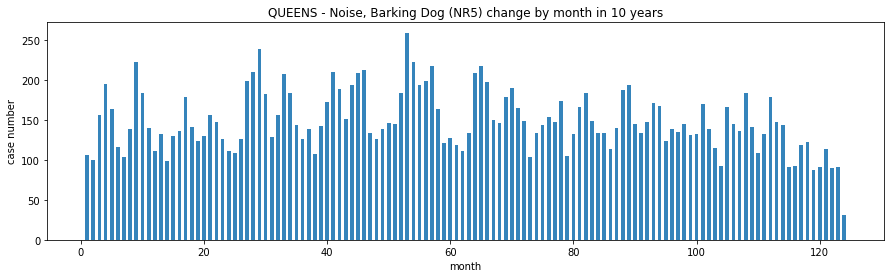

In [21]:
tempc = monthList[(monthList['Borough'] == 'QUEENS') & (monthList['Descriptor'] == 'Noise, Barking Dog (NR5)')]
cwh = [i for i in range(1,len(tempc)+1)]
tempc = tempc.sort_values(by=['year','month'])
plt.figure(figsize=(15,4))
plt.bar(cwh,height=tempc['monthSize'],width = 0.6,alpha=0.9)
plt.xlabel('month')
plt.ylabel('case number')
plt.title('QUEENS - Noise, Barking Dog (NR5) change by month in 10 years')

plt.show()

From the above four bar plots, we figured out that it is not what we thought. The trend of the four zones is very different from the trend of the staten island.
We therefore assume that it may be the result of local regulations or local natural disasters.


## Brooklyn 

We just mentioned that Brooklyn has the largest percentage of noise complaints in the loud music/party subcategory.

<br>Generally, Brooklyn is a artistic neighborhood, and the overall atmosphere is more hippy,hence, people from Brooklyn like music and parties very much.
<br>Similarly, bar plot is made according to the trend of the Loud/music party in Brooklyn in the past decade.Meanwhile, we also plot a 24-hour bar graph for decade.

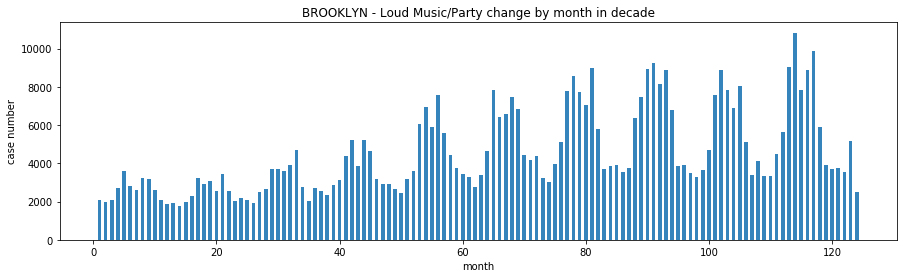

In [22]:
tempc = monthList[(monthList['Borough'] == 'BROOKLYN') & (monthList['Descriptor'] == 'Loud Music/Party')]
cwh = [i for i in range(1,len(tempc)+1)]
tempc = tempc.sort_values(by=['year','month'])
plt.figure(figsize=(15,4))
plt.bar(cwh,height=tempc['monthSize'],width = 0.6,alpha=0.9)
plt.xlabel('month')
plt.ylabel('case number')
plt.title('BROOKLYN - Loud Music/Party change by month in decade')

plt.show()

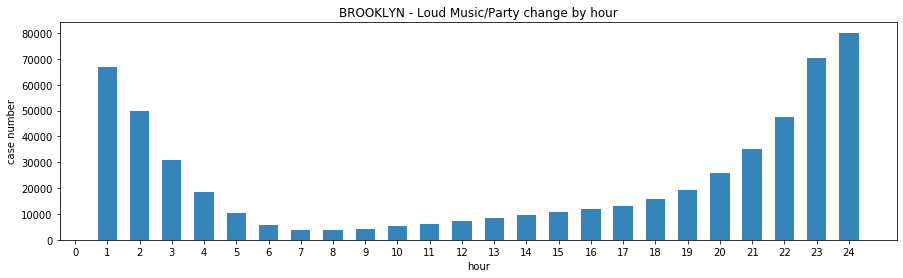

In [23]:
tempc = justHourList[(justHourList['Borough'] == 'BROOKLYN') & (justHourList['Descriptor'] == 'Loud Music/Party')]
cwh = [i for i in range(1,len(tempc)+1)]
tempc = tempc.sort_values(by=['hour'])
plt.figure(figsize=(15,4))
plt.bar(cwh,height=tempc['justHourSize'],width = 0.6,alpha=0.9)
plt.xlabel('hour')
plt.ylabel('case number')
plt.title('BROOKLYN - Loud Music/Party change by hour')
plt.xticks(range(25))
plt.show()

As can be seen from the above two figures, the noise complaint rate of Loud music/party in Brooklyn has been on the rise in the past ten years, which has a lot to do with the development of economy, technology and population. 

<br>Moreover, the distribution of complaints is seasonal, with more complaints in summer and less in winter. We found that there were 9 popular music festivals in Brooklyn in the Summer of 2019, such as Seaside Summer Concert Series, Brooklyn hip-hop Festival, Brooklyn Folk Festival,etc., attracting people from all over New York and even the United States.They run from may to September, mostly from June to August.

<br>It can be illustrate from the 24-hour bar chart, the volume of complaints in the evening is relatively high, while the volume of complaints in the daytime is relatively low, which is quite understandable. In the daytime, people are likely to be away from home and go to work, while when they need to sleep at night, they will be easily affected by loud music or party.

## Manhattan 

As can be seen from the bar chart, Manhattan accounts for a large proportion of noise complaints in both construction related noise, which are construction before/after hours and construction equipment, around 50% respectively.In addition, the percentage of noise complaints from air condition/ventilation equipment is far higher in Manhattan than in any of the other four boroughs.

<br>According to Manhattan construction research [Link](https://www2.colliers.com/en/research/new-york/1q-2019-manhattan-construction-report), although Manhattan is already one of the most densely populated and built areas in New York, there are still many new buildings under construction. Figure below shows delivery year of Manhattan building from 2019 to 2024.

![example](https://github.com/lingwsh/SocialData/blob/master/Final%20Project/img/qz_img/new_development.png?raw=true) 

Moreover, it is worth mentioning that the public transportation in Manhattan is the most developed in New York, so the construction of transportation hubs, such as subway stations, should also be taken into consideration.

#### Bronx

The BRONX is the birthplace of hip-hop, so we believe that it is  one of the reasons why the residents there love music. Therefore, in the top 10 noise complaints, Car/truck music and Loud music/party, two music-related noise complaints, accounted for the largest proportion.In addition to this, we wonder <br>whether the number of vehicles has a certain influence on the car music noise?Hence, we found statistics from NYCEDU on New York City car ownership rates in 2018.

![example](https://github.com/lingwsh/SocialData/blob/master/Final%20Project/img/qz_img/NYCDEC.png?raw=true)

The population density of Staten island is much lower than that of other boroughs. Even though the car ownership rate is the highest, the population density is the lowest, hence, the proportion of noise complaints from car or truck horn in this borough is still relatively low.<br>Except for Staten island,Queens has the highest rate of car ownership, followed bythe Bronx, while Manhattan has the lowest rate of car ownership, which we believe is because of the developed public transportation in Manhattan and it is not cost-effective to own a car in Manhattan.
<br>In addition, the Bronx residents are mainly of African and Latin American descent, so we assume that the area has a relatively high number of active residents Coupled with the love of music, it is easy to understand why the noise of car music accounts for the largest proportion in this area.

#### Queens

Finally, let's take a look at Queens, we just mentioned the car ownership ratein New York, and from this point of view, Queens has the highest rate of car ownership and we consider that is the main reason why the noise complaints of Car/Truck horn is the highest in Queens.

####  Brief summary

Based on the distribution of the top 10 noise subcategories in the five boroughs of New York in 2019, we have carried out some analysis and explored the possible reasons behind. The characteristics of the types of noise complaints presented in each borough were combined with the analysis of population density statistics, construction status, car ownership rate, local culture and other aspects. Through the spatial distribution of noise complaints and a certain temporal distribution, we can understand the generalization and basic characteristics of the five boroughs of New York.

# Relational analysis with other types

#### Scatter plot analysis
After analyze 5 noise with other 49 the highist rank complain type relationship , the result show a positive correlation Illegal Parking with 'Noise - Residential' , 'Noise - Street/Sidewalk' ,'Noise - Commercial' and 'Noise'.

Is this a coincidence? Or in the real world, there is indeed a connection between them, we use folium to draw a map to explore whether there is a spatial connection between them.

Each point in this plot is the total number in every month between two complain types. For example, in first plot, one point in (7807,2559) is mean in 2011-August, there are 7807 cases of Noise - Residential and 2259 cases of Illegal Parking. 

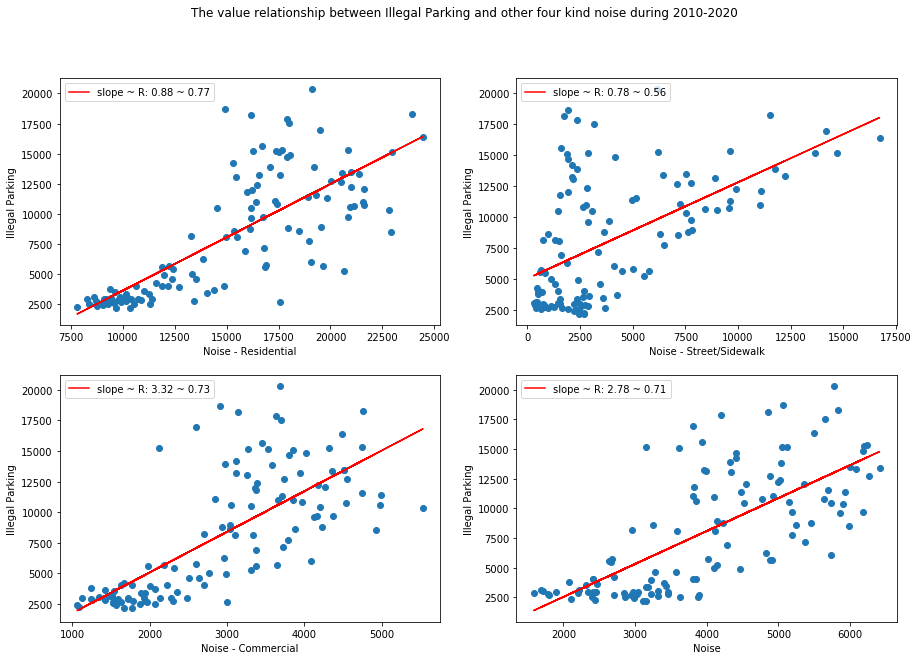

In [24]:

df = pd.read_csv('311-ac-monthGroupList.csv')
car_noise = ['Noise - Residential' , 'Noise - Street/Sidewalk' ,'Noise - Commercial' ,'Noise']
park = 'Illegal Parking'

f1,p1 = plt.subplots(2, 2, figsize=(15,10))
f1.suptitle('The value relationship between Illegal Parking and other four kind noise during 2010-2020')
k=0
n=0
big = 0
small = 0 
for kk in car_noise:
    
    temp = df[df["Complaint Type"]==kk]
    
    temp2 = df[df["Complaint Type"]==park]
    
    len1 = len(temp)
    len2 = len(temp2)
    if len1>len2:
        temp = temp.head(n = len2)
    else:
        temp2 = temp2.head(n = len1)
            
    slope, intercept, r_value, p_value, std_err = stats.linregress(temp['monthSize'],temp2['monthSize'])
    p1[n][k].scatter(temp['monthSize'],temp2['monthSize'],marker='o')
    p1[n][k].plot(temp['monthSize'], intercept + slope*temp['monthSize'], 'r',\
                  label='slope ~ R: '+str(round(slope, 2))+' ~ '+str(round(r_value, 2)))
    p1[n][k].set_xlabel(kk)
    p1[n][k].set_ylabel(park)
    p1[n][k].legend(loc="upper left")
    
    if(k == 1):
        n=n+1
        k=0
    else:
        k=k+1

#### Map structure introduction
In these four folium map, we grap 500 random GPS sample points from each catagory during year 2010-2020. The background heat map is always Illegal Parking distribution, then the points are sample from other four noise catagories.

#### Illegal Parking and Noise - Residential
In this map, The noisy concentrated areas are gathered near a large number of illegal parking. This is in line with certain practical conditions. It is likely that the noisy areas are densely populated and parking spaces are scarce.And this centralized distribution is relatively uniform, in line with the characteristics of people living.

In [25]:
df_whole = pd.read_csv('311-GPS-noise-parking.csv')
# the relationship between Illegal Parking and Noise - Residential
# Map show
borough_map='Borough Boundaries.geojson'
# Do the plotting with sampling: Scatter plot
map_hooray_scatter=folium.Map(location=[40.7128, -74.0060],tiles = "Stamen Toner",zoom_start=10.5)
selected=df_whole[df_whole['Complaint Type']=='Illegal Parking'].sample(500)
selected=selected[~np.isnan(selected['Latitude'])]
cmlist=selected[['Latitude','Longitude']].values.tolist()

selected_NR=df_whole[df_whole['Complaint Type']=='Noise - Residential'].sample(500)
selected_NR=selected_NR[~np.isnan(selected_NR['Latitude'])]
cmlist_NR=selected_NR[['Latitude','Longitude']].values.tolist()

folium.GeoJson(borough_map).add_to(map_hooray_scatter)
# for i in cmlist:
#     folium.CircleMarker(i,width=30, height=30, radius=3.5, weight=2.0, color='#0000CC', fill_color='#0066FF', opacity=0.75, fill_opacity=0.5).add_to(map_hooray_scatter)

for i in cmlist_NR:
    folium.CircleMarker(i,width=30, height=30, radius=3.5, weight=2.0, color='#0000CC', fill_color='#0066FF', opacity=0.75, fill_opacity=0.5).add_to(map_hooray_scatter)
HeatMap(cmlist,max_zoom=1000000,radius=20).add_to(map_hooray_scatter)
map_hooray_scatter

#### Illegal Parking and Noise - Street/Sidewalk
In the vicinity of illegal parking, there will be a lot of noise. Obviously, this noisy gathering is more concentrated in the middle of the illegal parking area, which may be a street or a commercial area where the crowd is concentrated.

In [26]:
# the relationship between Illegal Parking and Noise - Street/Sidewalk
# Map show
borough_map='Borough Boundaries.geojson'
# Do the plotting with sampling: Scatter plot
map_hooray_scatter=folium.Map(location=[40.7128, -74.0060],tiles = "Stamen Toner",zoom_start=10.5)
selected=df_whole[df_whole['Complaint Type']=='Illegal Parking'].sample(500)
selected=selected[~np.isnan(selected['Latitude'])]
cmlist=selected[['Latitude','Longitude']].values.tolist()

selected_NR=df_whole[df_whole['Complaint Type']=='Noise - Street/Sidewalk'].sample(500)
selected_NR=selected_NR[~np.isnan(selected_NR['Latitude'])]
cmlist_NR=selected_NR[['Latitude','Longitude']].values.tolist()

folium.GeoJson(borough_map).add_to(map_hooray_scatter)
# for i in cmlist:
#     folium.CircleMarker(i,width=30, height=30, radius=3.5, weight=2.0, color='#0000CC', fill_color='#0066FF', opacity=0.75, fill_opacity=0.5).add_to(map_hooray_scatter)

for i in cmlist_NR:
    folium.CircleMarker(i,width=30, height=30, radius=3.5, weight=2.0, color='#0000CC', fill_color='#0066FF', opacity=0.75, fill_opacity=0.5).add_to(map_hooray_scatter)
HeatMap(cmlist,max_zoom=1000000,radius=20).add_to(map_hooray_scatter)
map_hooray_scatter

#### Illegal Parking and Noise - Commercial
Noise-Commercial is more concentrated than Noise-Street / Sidewalk, and the range of commercial activities may be relatively fixed, not as widely distributed as the street. In areas where Noise-Commercia is more concentrated, it often coincides with dense parking spots. It shows that commercial noise and the use of transportation may be closely related.

In [27]:
# the relationship between Illegal Parking and Noise - Commercial
# Map show
borough_map='Borough Boundaries.geojson'
# Do the plotting with sampling: Scatter plot
map_hooray_scatter=folium.Map(location=[40.7128, -74.0060],tiles = "Stamen Toner",zoom_start=10.5)
selected=df_whole[df_whole['Complaint Type']=='Illegal Parking'].sample(500)
selected=selected[~np.isnan(selected['Latitude'])]
cmlist=selected[['Latitude','Longitude']].values.tolist()

selected_NR=df_whole[df_whole['Complaint Type']=='Noise - Commercial'].sample(500)
selected_NR=selected_NR[~np.isnan(selected_NR['Latitude'])]
cmlist_NR=selected_NR[['Latitude','Longitude']].values.tolist()

folium.GeoJson(borough_map).add_to(map_hooray_scatter)
# for i in cmlist:
#     folium.CircleMarker(i,width=30, height=30, radius=3.5, weight=2.0, color='#0000CC', fill_color='#0066FF', opacity=0.75, fill_opacity=0.5).add_to(map_hooray_scatter)

for i in cmlist_NR:
    folium.CircleMarker(i,width=30, height=30, radius=3.5, weight=2.0, color='#0000CC', fill_color='#0066FF', opacity=0.75, fill_opacity=0.5).add_to(map_hooray_scatter)
HeatMap(cmlist,max_zoom=1000000,radius=20).add_to(map_hooray_scatter)
map_hooray_scatter

#### Illegal Parking and Noise
From the figure, we can see that the noise is very concentrated in a specific area, this area is the most prosperous Manhattan. Explain that noise is related to specific areas. The reason behind it still needs us to explore further.

In [28]:
# the relationship between Illegal Parking and Noise
# Map show
borough_map='Borough Boundaries.geojson'
# Do the plotting with sampling: Scatter plot
map_hooray_scatter=folium.Map(location=[40.7128, -74.0060],tiles = "Stamen Toner",zoom_start=10.5)
selected=df_whole[df_whole['Complaint Type']=='Illegal Parking'].sample(500)
selected=selected[~np.isnan(selected['Latitude'])]
cmlist=selected[['Latitude','Longitude']].values.tolist()

selected_NR=df_whole[df_whole['Complaint Type']=='Noise'].sample(500)
selected_NR=selected_NR[~np.isnan(selected_NR['Latitude'])]
cmlist_NR=selected_NR[['Latitude','Longitude']].values.tolist()

folium.GeoJson(borough_map).add_to(map_hooray_scatter)
# for i in cmlist:
#     folium.CircleMarker(i,width=30, height=30, radius=3.5, weight=2.0, color='#0000CC', fill_color='#0066FF', opacity=0.75, fill_opacity=0.5).add_to(map_hooray_scatter)

for i in cmlist_NR:
    folium.CircleMarker(i,width=30, height=30, radius=3.5, weight=2.0, color='#0000CC', fill_color='#0066FF', opacity=0.75, fill_opacity=0.5).add_to(map_hooray_scatter)
HeatMap(cmlist,max_zoom=1000000,radius=20).add_to(map_hooray_scatter)
map_hooray_scatter

# Summary and Conclusion 最后完成